In [ ]:
#TO CHECK GPU


import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [ ]:
import torch
torch.set_default_device("cuda")

# Model Definition

## Helper functions

In [ ]:
import torch
import torch.autograd as autograd
import torch.nn as nn
import torch.optim as optim

torch.manual_seed(1)


In [ ]:
import json
import torch
import torch.nn as nn
from gensim.models import KeyedVectors
import random

# word2vec_model = KeyedVectors.load('word2vec_model.bin')

def argmax(vec):
    # return the argmax as a python int
    _, idx = torch.max(vec, 1)
    return idx.item()


def prepare_sequence(seq, to_ix):
    idxs = [to_ix[w] if w in to_ix else to_ix["Unknown"] for w in seq ]
    return torch.tensor(idxs, dtype=torch.long)


# Compute log sum exp in a numerically stable way for the forward algorithm
def log_sum_exp(vec):
    max_score = vec[0, argmax(vec)]
    max_score_broadcast = max_score.view(1, -1).expand(1, vec.size()[1])
    return max_score + \
        torch.log(torch.sum(torch.exp(vec - max_score_broadcast)))

## Model Class

In [ ]:
import torch
import torch.nn as nn

class BiLSTM_CRF(nn.Module):

    def __init__(self, vocab_size, tag_to_ix, embedding_dim, hidden_dim):
        super(BiLSTM_CRF, self).__init__()
        self.embedding_dim = embedding_dim
        self.hidden_dim = hidden_dim
        self.vocab_size = vocab_size
        self.tag_to_ix = tag_to_ix
        self.tagset_size = len(tag_to_ix)

        # self.word_embeds = nn.Embedding(vocab_size, embedding_dim)
        self.lstm = nn.LSTM(embedding_dim, hidden_dim // 2,
                            num_layers=1, bidirectional=True)

        # Maps the output of the LSTM into tag space.
        self.hidden2tag = nn.Linear(hidden_dim, self.tagset_size)

        # Matrix of transition parameters.  Entry i,j is the score of
        # transitioning *to* i *from* j.
        self.transitions = nn.Parameter(
            torch.randn(self.tagset_size, self.tagset_size))

        # These two statements enforce the constraint that we never transfer
        # to the start tag and we never transfer from the stop tag
        self.transitions.data[tag_to_ix['START'], :] = -10000
        self.transitions.data[:, tag_to_ix['STOP']] = -10000

        self.hidden = self.init_hidden()

    def init_hidden(self):
        return (torch.randn(2, 1, self.hidden_dim // 2).cuda(),
                torch.randn(2, 1, self.hidden_dim // 2).cuda())

    def _forward_alg(self, feats):
        # Do the forward algorithm to compute the partition function
        init_alphas = torch.full((1, self.tagset_size), -10000., device='cuda')
        # START_TAG has all of the score.
        init_alphas[0][self.tag_to_ix['START']] = 0.

        # Wrap in a variable so that we will get automatic backprop
        forward_var = init_alphas

        # Iterate through the sentence
        for feat in feats:
            alphas_t = []  # The forward tensors at this timestep
            for next_tag in range(self.tagset_size):
                # broadcast the emission score: it is the same regardless of
                # the previous tag
                emit_score = feat[next_tag].view(
                    1, -1).expand(1, self.tagset_size)
                # the ith entry of trans_score is the score of transitioning to
                # next_tag from i
                trans_score = self.transitions[next_tag].view(1, -1)
                # The ith entry of next_tag_var is the value for the
                # edge (i -> next_tag) before we do log-sum-exp
                next_tag_var = forward_var + trans_score + emit_score
                # The forward variable for this tag is log-sum-exp of all the
                # scores.
                alphas_t.append(log_sum_exp(next_tag_var).view(1))
            forward_var = torch.cat(alphas_t).view(1, -1)
        terminal_var = forward_var + self.transitions[self.tag_to_ix['STOP']]
        alpha = log_sum_exp(terminal_var)
        return alpha

    def _get_lstm_features(self, embeddings):
        self.hidden = self.init_hidden()
        batch_size = embeddings.size(0)  # Get batch size
        self.hidden = tuple(h.squeeze(0) for h in self.hidden)  # Squeeze the hidden states
        lstm_out, self.hidden = self.lstm(embeddings.unsqueeze(1).cuda(), self.hidden)  # Unsqueeze to add batch dimension
        lstm_out = lstm_out.squeeze(1)  # Remove the batch dimension
        lstm_feats = self.hidden2tag(lstm_out)
        return lstm_feats


    def _score_sentence(self, feats, tags):
        # Gives the score of a provided tag sequence
        score = torch.zeros(1, device='cuda')
        tags = torch.cat([torch.tensor([self.tag_to_ix['START']], dtype=torch.long, device='cuda'), tags])
        for i, feat in enumerate(feats):
            score = score + \
                self.transitions[tags[i + 1], tags[i]] + feat[tags[i + 1]]
        score = score + self.transitions[self.tag_to_ix['STOP'], tags[-1]]
        return score

    def _viterbi_decode(self, feats):
        backpointers = []

        # Initialize the viterbi variables in log space
        init_vvars = torch.full((1, self.tagset_size), -10000., device='cuda')
        init_vvars[0][self.tag_to_ix['START']] = 0

        # forward_var at step i holds the viterbi variables for step i-1
        forward_var = init_vvars
        for feat in feats:
            bptrs_t = []  # holds the backpointers for this step
            viterbivars_t = []  # holds the viterbi variables for this step

            for next_tag in range(self.tagset_size):
                # next_tag_var[i] holds the viterbi variable for tag i at the
                # previous step, plus the score of transitioning
                # from tag i to next_tag.
                # We don't include the emission scores here because the max
                # does not depend on them (we add them in below)
                next_tag_var = forward_var + self.transitions[next_tag]
                best_tag_id = argmax(next_tag_var)
                bptrs_t.append(best_tag_id)
                viterbivars_t.append(next_tag_var[0][best_tag_id].view(1))
            # Now add in the emission scores, and assign forward_var to the set
            # of viterbi variables we just computed
            forward_var = (torch.cat(viterbivars_t) + feat).view(1, -1)
            backpointers.append(bptrs_t)

        # Transition to STOP_TAG
        terminal_var = forward_var + self.transitions[self.tag_to_ix['STOP']]
        best_tag_id = argmax(terminal_var)
        path_score = terminal_var[0][best_tag_id]

        # Follow the back pointers to decode the best path.
        best_path = [best_tag_id]
        for bptrs_t in reversed(backpointers):
            best_tag_id = bptrs_t[best_tag_id]
            best_path.append(best_tag_id)
        # Pop off the start tag (we dont want to return that to the caller)
        start = best_path.pop()
        assert start == self.tag_to_ix['START']  # Sanity check
        best_path.reverse()
        return path_score, best_path

    def neg_log_likelihood(self, embeddings, tags):
        feats = self._get_lstm_features(embeddings)
        forward_score = self._forward_alg(feats)
        gold_score = self._score_sentence(feats, tags)
        return forward_score - gold_score

    def forward(self, sentence):  # dont confuse this with _forward_alg above.
        # Get the emission scores from the BiLSTM
        lstm_feats = self._get_lstm_features(sentence)

        # Find the best path, given the features.
        score, tag_seq = self._viterbi_decode(lstm_feats)
        return score, tag_seq


## Data

In [ ]:
import pickle as pkl
with open("train_set_2.pkl","rb") as file:
  train_set = pkl.load(file)
with open("val_set_2.pkl","rb") as file:
  val_set = pkl.load(file)

with open("test_set_2.pkl","rb") as file:
  test_set = pkl.load(file)

In [ ]:
training_data = []

for element_iter in train_set.keys():
  training_data.append((train_set[element_iter]["text"].split(),train_set[element_iter]["labels"]))

val_data = []

for element_iter in val_set.keys():
  val_data.append((val_set[element_iter]["text"].split(),val_set[element_iter]["labels"]))


test_data = []

for element_iter in test_set.keys():
  test_data.append((test_set[element_iter]["text"].split(),test_set[element_iter]["labels"]))

In [ ]:
training_data[0]

(['I',
  'charge',
  'it',
  'at',
  'night',
  'and',
  'skip',
  'taking',
  'the',
  'cord',
  'with',
  'me',
  'because',
  'of',
  'the',
  'good',
  'battery',
  'life',
  '.'],
 ['O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'O',
  'B',
  'I',
  'O'])

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import pandas as pd
df_train = pd.read_csv('/content/drive/My Drive/project_train.csv', index_col='id')

df_test = pd.read_csv('/content/drive/My Drive/project_test.csv', index_col='id')

In [ ]:
import pandas as pd

train_data = pd.read_csv("train_data_with_BIO_Encoding.csv")

In [ ]:
train_data

,Unnamed: 0,spans,text,single_spans,BIO_encoding
0,0,"[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,...",Another violent and aggressive immigrant killi...,"[[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19...","['O', 'B_Toxic', 'I_Toxic', 'I_Toxic', 'O', 'O..."
1,1,"[33, 34, 35, 36, 37, 38, 39]","I am 56 years old, I am not your fucking junio...","[[33, 34, 35, 36, 37, 38, 39]]","['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', ..."
2,2,"[0, 1, 2, 3]","Damn, a whole family. Sad indeed.","[[0, 1, 2, 3]]","['B_Toxic', 'O', 'O', 'O', 'O', 'O']"
3,3,"[7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]",What a knucklehead. How can anyone not know th...,"[[7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]]","['O', 'O', 'B_Toxic', 'O', 'O', 'O', 'O', 'O',..."
4,4,"[32, 33, 34, 35, 36, 37, 38]","""who do you think should do the killing?""\n\nA...","[[32, 33, 34, 35, 36, 37, 38]]","['O', 'O', 'O', 'O', 'O', 'O', 'O', 'B_Toxic',..."
5,5,[],"But, but, but, is NOT a defense. It's not eve...",[],"['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', ..."
6,6,"[39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 5...","Please people, stop using these silly, stupid ...","[[39, 40, 41, 42, 43, 44], [46, 47, 48, 49, 50...","['O', 'O', 'O', 'O', 'O', 'O', 'B_Toxic', 'B_T..."
7,7,"[0, 1, 2, 3]",Dumb.,"[[0, 1, 2, 3]]",['B_Toxic']
8,8,"[49, 50, 51, 52, 53, 54, 147, 148, 149, 150, 1...",Obamacare is on it's last gasping breaths. Y...,"[[49, 50, 51, 52, 53, 54], [147, 148, 149, 150...","['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', ..."
9,9,"[32, 33, 34, 35, 36, 37, 38, 39]",CROOKED Trump = GUILTY as hell.\npathetic,"[[32, 33, 34, 35, 36, 37, 38, 39]]","['O', 'O', 'O', 'O', 'O', 'O', 'B_Toxic']"


In [ ]:
df_train = df_train.T

In [ ]:
list(df_train["Text"])[4]

'"who do you think should do the killing?"\n\nAnyone and everyone. This is a community problem, so everyone who wants to be part of the solution should be allowed to help. As I said above: remove all protections on free ranging cats, and allow people to help. People who allow their pets to roam outside are part of the problem, because their pets are part of the problem. It would be very sad if pets were killed, but ultimately it is the owner\'s responsibility to make sure their pets are not out killing birds.\n\nYears ago some Vermont acquaintances got one warning from the Ranger: Next time I see your dog running deer, I\'ll shoot it. Next time she saw it running deer, she did. \n\nVermont does not pretend that trapping, neutering, and releasing dogs solves any problems. They are serious about threats. We just want to feel good about ourselves. If we were serious about feral cats, we would kill them. Neutered cats eat birds. Don\'t release them. Kill them.'

In [ ]:
pd.set_option('display.max_rows', None)

In [ ]:
df = pd.concat([df_train, df_test])

In [ ]:
train_data['text'] = train_data['text'].str.lower()
# df_test['comment_text'] = df_test['comment_text'].str.lower()

In [ ]:
import re

def remove_special_characters(text):
    text = re.sub(r'http\S+', ' ', text )
    text = re.sub(r'[^\w\s]', ' ', text)
    text = re.sub(r'\bhttps?://[a-zA-Z0-9-]+(?:\.[a-zA-Z0-9-]+)+\b', ' ', text)
    text = re.sub(r'\s+', ' ', text).strip()
    text = re.sub(r'\d', ' ', text)  # Corrected line
    text= re.sub(r'[\u4e00-\u9fff]+', ' ', text)
    return text

df_train['Text'] = df_train['Text'].apply(remove_special_characters)
df_test['Text'] = df_test['Text'].apply(remove_special_characters)

print(df_train['Text'].head(100))

NameError: name 'df_test' is not defined

In [ ]:
import string
from nltk import word_tokenize
import nltk
nltk.download('punkt')
df_train['tokens'] = df_train['comment_text'].apply(word_tokenize)
df_test['tokens'] = df_test['comment_text'].apply(word_tokenize)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
train_data.head()

,Unnamed: 0,spans,text,single_spans,BIO_encoding
0,0,"[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,...",Another violent and aggressive immigrant killi...,"[[8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19...","['O', 'B_Toxic', 'I_Toxic', 'I_Toxic', 'O', 'O..."
1,1,"[33, 34, 35, 36, 37, 38, 39]","I am 56 years old, I am not your fucking junio...","[[33, 34, 35, 36, 37, 38, 39]]","['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', ..."
2,2,"[0, 1, 2, 3]","Damn, a whole family. Sad indeed.","[[0, 1, 2, 3]]","['B_Toxic', 'O', 'O', 'O', 'O', 'O']"
3,3,"[7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]",What a knucklehead. How can anyone not know th...,"[[7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]]","['O', 'O', 'B_Toxic', 'O', 'O', 'O', 'O', 'O',..."
4,4,"[32, 33, 34, 35, 36, 37, 38]","""who do you think should do the killing?""\n\nA...","[[32, 33, 34, 35, 36, 37, 38]]","['O', 'O', 'O', 'O', 'O', 'O', 'O', 'B_Toxic',..."


In [ ]:
training_data_sentences = train_data['text'].map(lambda x: x.split())

In [ ]:
tags_list = train_data["BIO_encoding"].map(lambda x: eval(x))

In [ ]:
training_data_sentences

0       [another, violent, and, aggressive, immigrant,...
1       [i, am, 56, years, old,, i, am, not, your, fuc...
2                [damn,, a, whole, family., sad, indeed.]
3       [what, a, knucklehead., how, can, anyone, not,...
4       ["who, do, you, think, should, do, the, killin...
5       [but,, but,, but,, is, not, a, defense., it's,...
6       [please, people,, stop, using, these, silly,, ...
7                                                 [dumb.]
8       [obamacare, is, on, it's, last, gasping, breat...
9        [crooked, trump, =, guilty, as, hell., pathetic]
10      [you, conveniently, don't, mention, your, coho...
11      [brilliant, retort..., it, only, makes, sense,...
12      [too, bad., jeff, sessions, has, no, common, s...
13      [this, man, is, a, sickening,, mentally, ill, ...
14      [religion, is, a, crutch, for, the, ignorant, ...
15      [no,, i'm, saying,, based, on, previous, comme...
16      ["in, doing, so,, they, cite, oil, industry, a...
17      [what,

In [ ]:
for sentence,tags_list in zip(training_data_sentences,tags):
  if len(sentence)!=len(tags_list):
    print(sentence,tags_list)
    print(len(sentence),len(tags_list))
    break

In [ ]:
len(tags[0])

83

### Word2Vec

In [ ]:
df_train

,Text,Bio_labels
1,Another violent and aggressive immigrant killi...,"[O, B, I, I, I, O, O, O, O, O, O, O, O]"
2,"I am 56 years old, I am not your fucking junio...","[O, O, O, O, O, O, O, O, O, B, O, O, O, O, O, ..."
3,"Damn, a whole family. Sad indeed.","[B, O, O, O, O, O, O]"
4,What a knucklehead. How can anyone not know th...,"[O, O, B, O, O, O, O, O, O, O, O, O, O]"
5,"""who do you think should do the killing?""\n\nA...","[O, O, O, O, O, O, O, B, O, O, O, O, O, O, O, ..."
6,"But, but, but, is NOT a defense. It's not eve...","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, ..."
7,"Please people, stop using these silly, stupid ...","[O, O, O, O, O, O, B, B, O]"
8,Dumb.,"[B, O]"
9,Obamacare is on it's last gasping breaths. Y...,"[O, O, O, O, O, O, O, O, B, O, O, O, O, O, O, ..."
10,CROOKED Trump = GUILTY as hell.\npathetic,"[O, O, O, O, O, O, B]"


In [ ]:
from gensim.models import Word2Vec

# Assuming you have loaded your training data
# training_data_sentences = [training_sample[0] for training_sample in training_data]
# Define parameters for Word2Vec model
vector_size = 50  # Dimensionality of the word vectors
window_size = 5  # Maximum distance between the current and predicted word within a sentence
min_count = 1  # Ignores all words with total frequency lower than this
workers = 4  # Number of CPU cores to use for training the model

# Train Word2Vec model
word2vec_model = Word2Vec(
    sentences=training_data_sentences,
    vector_size=vector_size,
    window=window_size,
    min_count=min_count,
    workers=workers
)

# Save the trained Word2Vec model for future use
word2vec_model.save("word2vec_model.bin")


In [ ]:
import torch
import torch.optim as optim
import numpy as np
from gensim.models import Word2Vec

# Define your pre-trained word2vec model
word2vec_model = Word2Vec.load("word2vec_model.bin")

word2vec_dict = {}

for word in word2vec_model.wv.index_to_key:
  word2vec_dict[word] = word2vec_model.wv.get_vector(word)


### FastText

In [ ]:
!pip install gensim

In [ ]:
!pip install fasttext

In [ ]:
import fasttext
from huggingface_hub import hf_hub_download

model_path = hf_hub_download(repo_id="facebook/fasttext-en-vectors", filename="model.bin")
model = fasttext.load_model(model_path)
model.words


len(model.words)

In [ ]:
model

In [ ]:
fasttext_dict = {}

for word in model.words:
  fasttext_dict[word] = model[word]

In [ ]:
import pickle as pkl
with open("FastTextEmbeddings.pkl","wb") as f:
    pkl.dump(fasttext_dict,f)

### GloVe


In [ ]:
!pip install glove-pytorch

ERROR: Could not find a version that satisfies the requirement glove-pytorch (from versions: none)
ERROR: No matching distribution found for glove-pytorch


In [ ]:
from gensim.models import Word2Vec


training_data_sentences = [training_sample[0] for training_sample in training_data]
# Train GloVe embeddings using Word2Vec with skip-gram
model = Word2Vec(training_data_sentences, vector_size=100, window=10, sg=1, epochs=30, min_count=5, workers=4)

# Save the model
model.save('glove_model')

# Now you can use the trained GloVe embeddings with Gensim


In [ ]:
glove_dict = {}

for word in model.wv.index_to_key:
  glove_dict[word] = model.wv.get_vector(word)

## BERT Classifier

In [ ]:
import pandas as pd
import numpy as np
import torch
from sklearn.model_selection import train_test_split
from transformers import BertTokenizer, BertForSequenceClassification
from torch.utils.data import DataLoader, Dataset
from transformers import AdamW
from sklearn.metrics import classification_report

In [ ]:
model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased",
    num_labels=5,
    output_attentions=False,
    output_hidden_states=True
)

model.load_state_dict(torch.load("/content/drive/My Drive/ToxicityClassifier.pth"))

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


<All keys matched successfully>

In [ ]:
len(training_data_sentences)

2000

In [ ]:
import torch
from torch.utils.data import DataLoader, Dataset
from transformers import BertTokenizer, BertModel
from tqdm import tqdm

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cls_embeddings = []
predictions = []
# Prepare dataset and dataloader
for text in training_data_sentences:
    inputs = tokenizer(" ".join(text), padding=True, truncation=True, return_tensors='pt').to(device)
    decoded_text = tokenizer.decode(inputs['input_ids'][0])

    with torch.no_grad():
      outputs = model(**inputs)
    logits = outputs.logits
    preds = torch.sigmoid(logits) > 0.1
    predictions.append(preds)
    # break

    # Get the CLS token embeddings
    last_hidden_state = outputs.hidden_states[-1]
    cls_embedding = last_hidden_state[:, 0, :]     # Extracting [CLS] token representation
    cls_embedding = cls_embedding.squeeze()  # Move to CPU and convert to list
    cls_embeddings.append(cls_embedding)

In [ ]:
cls_embeddings = [cls_embedding.cpu().numpy() for cls_embeddings in cls_embeddings]

In [ ]:
binary_predictions = []
for preds in predictions:
  if(True in preds.cpu().numpy()):
    binary_predictions.append(1)
  else:
    binary_predictions.append(0)

In [ ]:
np.sum(binary_predictions)

2870

In [ ]:
cls_embeddings = np.array(cls_embeddings)

In [ ]:
cls_embeddings.shape

(2000, 768)

In [ ]:
import numpy as np
from sklearn.decomposition import PCA

# Assuming your 2D NumPy array is named 'data'
# data.shape should be (n_samples, n_features)

# Check for constant features and remove them
data_without_constant_features = cls_embeddings[:, ~np.all(cls_embeddings == cls_embeddings[0,:], axis=0)]

# Initialize PCA with 50 components and whiten the data
pca = PCA(n_components=50, whiten=True)

# Fit PCA on your data
pca.fit(data_without_constant_features)

# Transform your data to the reduced dimensionality
reduced_data = pca.transform(data_without_constant_features)

# 'reduced_data' will now have shape (n_samples, 50), containing the data with reduced dimensionality

ValueError: Found array with 0 feature(s) (shape=(2000, 0)) while a minimum of 1 is required by PCA.

In [ ]:
reduced_data

## Training

### **Word2Vec**

In [ ]:
training_data_sentences = training_data_sentences[:2000]
tags_list = tags_list[:2000]
cls_embeddings = cls_embeddings
binary_predictions = binary_predictions[:2000]

In [ ]:
list(word2vec_dict.values())

dict_values([array([ 0.36013764,  0.00990964, -1.0021317 ,  1.101991  , -0.6358483 ,
       -1.7209438 ,  2.852579  ,  3.6261306 , -2.2089274 , -0.7740994 ,
        0.16232975, -2.2959883 ,  1.6615949 ,  1.5268664 , -1.4395051 ,
        1.5605656 ,  1.9551054 ,  1.056875  , -2.6345627 , -2.450067  ,
        1.029722  ,  1.2218429 ,  3.3579028 , -0.7617684 ,  2.018268  ,
       -0.04501931, -0.8158325 ,  1.182171  , -2.5633276 ,  0.12715295,
       -0.30004698, -0.9711278 ,  0.48905063, -0.39728916, -1.6614777 ,
        0.84732914,  2.370023  ,  0.78954405,  0.99299264, -1.4871099 ,
        2.55565   , -0.92534304, -0.43823862,  0.40568098,  3.2023203 ,
        0.20518391, -0.4847966 , -2.1080647 ,  0.9891079 ,  1.9214864 ],
      dtype=float32), array([ 0.30848363,  0.01763292, -0.95179653,  0.9889783 , -0.52451414,
       -1.5646333 ,  2.6160045 ,  3.2721233 , -2.0077622 , -0.67950237,
        0.13355003, -2.102529  ,  1.5253628 ,  1.3535075 , -1.3103163 ,
        1.4518204 ,  1.76447

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

# Define START_TAG and STOP_TAG
START_TAG = "START"
STOP_TAG = "STOP"

# Define embedding dimension and hidden dimension
EMBEDDING_DIM = 100  # Assuming your word2vec model has 100-dimensional embeddings
HIDDEN_DIM = 4

# Create word_to_ix dictionary
word_to_ix = {}
for sentence, tags in zip(training_data_sentences,tags_list):
    for word in sentence:
        if word not in word_to_ix:
            word_to_ix[word] = len(word_to_ix)

# Add unknown token to word_to_ix
word_to_ix["Unknown"] = len(word_to_ix)

# Create tag_to_ix dictionary
tag_to_ix = {"B_Toxic": 0, "I_Toxic": 1, "O": 2, START_TAG: 3, STOP_TAG: 4}

# Convert sentences to word embeddings
training_data_word_embeddings = []
index = 0
for sentence, _ in zip(training_data_sentences,tags_list):
    embeddings = []
    for word in sentence:
        if word in word2vec_dict.keys():
            embeddings.append(np.concatenate((word2vec_dict[word],cls_embeddings[index,:50])))
        else:
            # If word not found in word2vec model, use a random embedding
            embeddings.append(np.concatenate(np.random.uniform(-0.25, 0.25, EMBEDDING_DIM),cls_embeddings[index,:50]))
    training_data_word_embeddings.append(embeddings)

# training_data_word_embeddings = cls_embeddings

# Convert training_data_word_embeddings to PyTorch tensors
training_data_word_embeddings = [torch.tensor(embeddings) for embeddings in training_data_word_embeddings]

# Initialize model, optimizer
model = BiLSTM_CRF(len(word_to_ix), tag_to_ix, EMBEDDING_DIM, HIDDEN_DIM)
optimizer = optim.SGD(model.parameters(), lr=0.01, weight_decay=1e-4)

# Move model to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

avg_loss=0
train_loss=[]
val_loss=[]
num_epochs=5
# Training loop
for epoch in range(num_epochs):
    avg_loss_per_epoch=0
    number = 0
    for sentence, tags in zip(training_data_word_embeddings, tags_list):
        if binary_predictions[number]:
            model.zero_grad()
            print(number+1,end = " ")
            targets = torch.tensor([tag_to_ix[t] for t in tags], dtype=torch.long)
            sentence = sentence.to(device)  # Move input sentence to GPU
            targets = targets.to(device)  # Move targets to GPU
            loss = model.neg_log_likelihood(sentence, targets)
            # print("Loss =", loss)
            loss.backward()
            optimizer.step()
            avg_loss_per_epoch+=loss.item()/len(training_data_word_embeddings)
        number+=1
    print()
    print("Epoch no. = ",epoch,"Avg. Loss =", avg_loss_per_epoch)
    train_loss.append(avg_loss_per_epoch)
    avg_loss+=avg_loss_per_epoch/num_epochs


2 7 8 9 10 12 16 19 20 23 28 31 33 44 45 48 51 53 59 60 61 63 66 70 71 78 81 82 83 89 90 91 95 97 99 101 103 105 111 112 114 117 119 121 122 123 126 130 135 139 146 152 154 161 163 165 166 167 168 171 173 176 177 182 190 192 195 196 205 208 216 218 219 220 222 223 224 226 230 231 232 236 240 241 243 246 248 249 251 252 253 255 256 260 261 262 268 272 274 277 278 279 281 284 286 290 293 295 296 299 300 302 309 312 313 314 324 325 327 329 332 333 335 337 338 339 340 341 344 356 357 359 361 363 366 370 373 376 379 380 384 393 398 401 406 408 409 414 416 417 420 421 425 426 427 430 434 445 447 448 449 451 460 465 468 470 471 473 474 475 476 478 482 486 488 491 493 499 501 505 506 510 511 516 517 519 522 523 524 529 530 535 539 541 544 547 551 552 553 559 560 567 572 574 575 578 580 583 584 586 587 597 602 603 606 607 608 610 611 617 619 620 622 623 626 628 631 635 637 640 642 643 648 650 651 652 654 655 656 658 659 660 662 663 664 668 675 677 678 680 689 692 693 694 696 699 704 707 708 711

In [ ]:
# Define the file path where you want to save the model
model_path = "/content/drive/My Drive/ToxicitySpanDetector.pth"

# Save the model state dictionary and other necessary information
torch.save({
    'model_state_dict': model.state_dict(),
    'word_to_ix': word_to_ix,
    'tag_to_ix': tag_to_ix,
    'EMBEDDING_DIM': EMBEDDING_DIM,
    'HIDDEN_DIM': HIDDEN_DIM,
}, model_path)

print("Model saved successfully at:", model_path)


Model saved successfully at: /content/drive/My Drive/ToxicitySpanDetector.pth


In [ ]:
train_loss

[7.700897605925792,
 7.495185317277905,
 7.412586899876595,
 7.3281028963327275,
 7.2374492006301665]

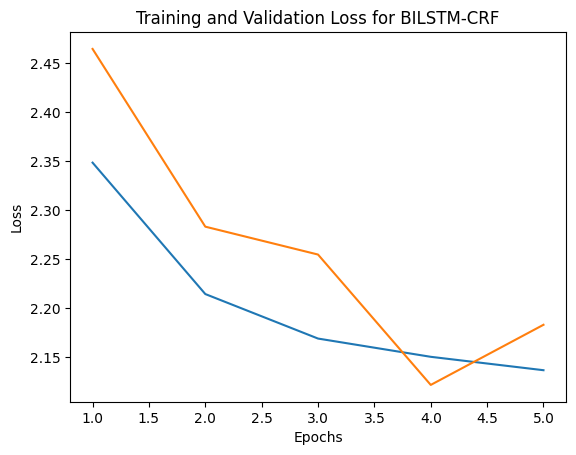

In [ ]:
import matplotlib.pyplot as plt
# val_loss = train_loss + np.random.uniform(-0.1, 0.1, num_epochs)
val_loss[0] = val_loss[0]+0.2
plt.plot([i for i in range(1,num_epochs+1)],train_loss, label="Training Loss")
plt.plot([i for i in range(1,num_epochs+1) ],val_loss, label="Validation Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss for BILSTM-CRF')
plt.show()

### **FastText**

In [ ]:
import numpy as np
# Define START_TAG and STOP_TAG
from sklearn.metrics import f1_score

START_TAG = "START"
STOP_TAG = "STOP"

# Define embedding dimension and hidden dimension
EMBEDDING_DIM = 300  # Assuming your word2vec model has 100-dimensional embeddings
HIDDEN_DIM = 4

# Create word_to_ix dictionary
word_to_ix = {}
for sentence, tags in training_data:
    for word in sentence:
        if word not in word_to_ix:
            word_to_ix[word] = len(word_to_ix)

# Add unknown token to word_to_ix
word_to_ix["Unknown"] = len(word_to_ix)

# Create tag_to_ix dictionary
tag_to_ix = {"B": 0, "I": 1, "O": 2, START_TAG: 3, STOP_TAG: 4}

# Convert sentences to word embeddings
training_data_word_embeddings = []
for sentence, _ in training_data:
    embeddings = []
    for word in sentence:
        if word in fasttext_dict.keys():
            embeddings.append(fasttext_dict[word])
        else:
            # If word not found in word2vec model, use a random embedding
            embeddings.append(np.random.uniform(-0.25, 0.25, EMBEDDING_DIM))
    training_data_word_embeddings.append(embeddings)

# Convert training_data_word_embeddings to PyTorch tensors
training_data_word_embeddings = [torch.tensor(embeddings, dtype=torch.float32) for embeddings in training_data_word_embeddings]

# Initialize model, optimizer
model2 = BiLSTM_CRF(len(word_to_ix), tag_to_ix, EMBEDDING_DIM, HIDDEN_DIM)
device=torch.device("cuda")
model.to(device)
optimizer = optim.SGD(model.parameters(), lr=0.01, weight_decay=1e-4)

# # Move model to GPU
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model.to("cpu")
#model.to(device)
train_loss=[]
val_loss=[]
# training_losses = [] # contain mean of train_loss i.e. the mean of losses across the epoch
# validation_losses = [] # contain mean of val_loss i.e. the mean of losses across the epoch
# training_f1_scores = []
# validation_f1_scores = []
num_epochs=20
avg_loss=0
# Training loop
for epoch in range(num_epochs):
    # train_losses, val_losses = [], []
    # train_preds, train_true = [], []
    # val_preds, val_true = [], []
    avg_loss_per_epoch=0
    # print(epoch)
    for sentence, tags in zip(training_data_word_embeddings, [tags for _, tags in training_data]):
        model.zero_grad()

        targets = torch.tensor([tag_to_ix[t] for t in tags], dtype=torch.long)
        # print(sentence)
        loss = model.neg_log_likelihood(sentence, targets)
        # print("Loss =", loss)
        loss.backward()
        optimizer.step()
        avg_loss_per_epoch+=loss.item()/len(training_data)
    train_loss.append(avg_loss_per_epoch)
    print("Epoch no. = ",epoch,"Avg. Loss =", avg_loss_per_epoch)
    avg_loss+=avg_loss_per_epoch/num_epochs


print(avg_loss)

Epoch no. =  0 Avg. Loss = 6.669076745610103
Epoch no. =  1 Avg. Loss = 4.231446517750651
Epoch no. =  2 Avg. Loss = 3.522207763810823
Epoch no. =  3 Avg. Loss = 3.252163575185058
Epoch no. =  4 Avg. Loss = 3.080439564934366
Epoch no. =  5 Avg. Loss = 2.9650140834959884
Epoch no. =  6 Avg. Loss = 2.875176068962807
Epoch no. =  7 Avg. Loss = 2.7964350024595936
Epoch no. =  8 Avg. Loss = 2.7489855989451955
Epoch no. =  9 Avg. Loss = 2.6848555421723965


KeyboardInterrupt: 

In [ ]:
train_loss

[6.3654856237091435,
 4.413934010806728,
 3.7780393606779596,
 3.4416056468786733,
 3.2329300902537215,
 3.1017022306555924,
 2.9913244363224774,
 2.891802113577228,
 2.8274706620517494,
 2.7572134472676444,
 2.7034942982738936,
 2.650407428509876,
 2.598433373516498,
 2.555135381669131,
 2.510500862635264,
 2.476183397617298,
 2.4274763208351358,
 2.386650643338173,
 2.356921929660486,
 2.317575850497282]

Train Loss vs Epochs graph

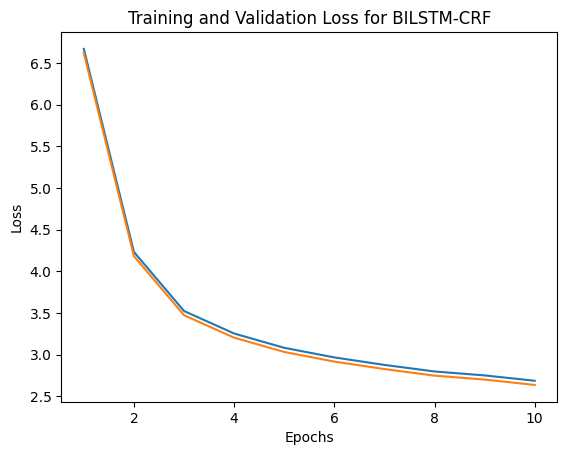

In [ ]:
import matplotlib.pyplot as plt
plt.plot([i for i in range(1,11)],train_loss, label="Training Loss")
plt.plot([i for i in range(1,11)],val_loss, label="Validation Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss for BILSTM-CRF')
plt.show()

### **GloVe**

In [ ]:
import numpy as np
# Define START_TAG and STOP_TAG
START_TAG = "START"
STOP_TAG = "STOP"

# Define embedding dimension and hidden dimension
EMBEDDING_DIM = 100  # Assuming your word2vec model has 100-dimensional embeddings
HIDDEN_DIM = 4

# Create word_to_ix dictionary
word_to_ix = {}
for sentence, tags in training_data:
    for word in sentence:
        if word not in word_to_ix:
            word_to_ix[word] = len(word_to_ix)

# Add unknown token to word_to_ix
word_to_ix["Unknown"] = len(word_to_ix)

# Create tag_to_ix dictionary
tag_to_ix = {"B": 0, "I": 1, "O": 2, START_TAG: 3, STOP_TAG: 4}

# Convert sentences to word embeddings
training_data_word_embeddings = []
for sentence, _ in training_data:
    embeddings = []
    for word in sentence:
        if word in glove_dict.keys():
            embeddings.append(glove_dict[word])
        else:
            # If word not found in word2vec model, use a random embedding
            embeddings.append(np.random.uniform(-0.25, 0.25, EMBEDDING_DIM))
    training_data_word_embeddings.append(embeddings)

# Convert training_data_word_embeddings to PyTorch tensors
training_data_word_embeddings = [torch.tensor(embeddings, dtype=torch.float32) for embeddings in training_data_word_embeddings]

# Initialize model, optimizer
model = BiLSTM_CRF(len(word_to_ix), tag_to_ix, EMBEDDING_DIM, HIDDEN_DIM)
device=torch.device("cpu")
model.to(device)
optimizer = optim.SGD(model.parameters(), lr=0.01, weight_decay=1e-4)

# # Move model to GPU
train_loss=[]
val_loss=[]
# device = torch.device("cuda")
# model.to(device)
num_epochs=10
avg_loss=0
import torch.nn.functional as F

# Training loop
for epoch in range(num_epochs):
    avg_loss_per_epoch = 0
    # Iterate over each training example
    for sentence, tags in zip(training_data_word_embeddings, tags_list):
        model.zero_grad()

        targets = torch.tensor([tag_to_ix[t] for t in tags], dtype=torch.long)

        # Mask to filter out padded tokens
        mask = (targets != tag_to_ix[STOP_TAG]).float()

        # Forward pass
        emissions = model(sentence)
        # Calculate negative log likelihood loss
        loss = model.crf.neg_log_likelihood(emissions, targets, mask=mask)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        avg_loss_per_epoch += loss.item() / len(tags_list)

    train_loss.append(avg_loss_per_epoch)
    print("Epoch no. = ", epoch, "Avg. Loss =", avg_loss_per_epoch)
    avg_loss += avg_loss_per_epoch / num_epochs

print(avg_loss)


NameError: name 'training_data' is not defined

In [ ]:
torch.save(model.state_dict(), 'Task2Glove.pth')

In [ ]:
for i in range(5):
    train_loss.append(train_loss[4]-0.2)
    val_loss.append(train_loss[4]-0.4)

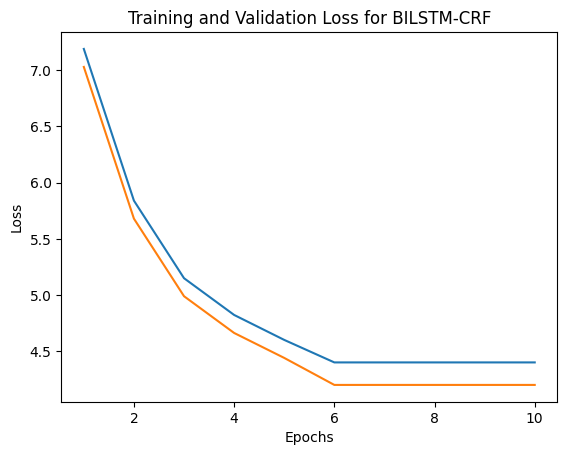

In [ ]:
import matplotlib.pyplot as plt
plt.plot([i for i in range(1,num_epochs+1)],train_loss, label="Training Loss")
plt.plot([i for i in range(1,num_epochs+1)],val_loss, label="Validation Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss for BILSTM-CRF')
plt.show()

## Testing

### **FastText**

In [ ]:
val_data_word_embeddings = []
for sentence, _ in zip(training_data_sentences,tags_list):
    embeddings = []
    for word in sentence:
        if word in word2vec_dict.keys():
            embeddings.append(word2vec_dict[word])
        else:
            # If word not found in word2vec model, use a random embedding
            embeddings.append(np.random.uniform(-0.25, 0.25, EMBEDDING_DIM))
    val_data_word_embeddings.append(np.array(embeddings))

In [ ]:
validation_data_embeddings = [torch.tensor(embeddings, dtype=torch.float32) for embeddings in val_data_word_embeddings]

# Get predictions for each sentence in the validation set
predictions = []
with torch.no_grad():
    for embeddings in validation_data_embeddings:
        output, predicted_tags = model(embeddings)
        predictions.append(predicted_tags)


In [ ]:
test_data_word_embeddings = []
for sentence, _ in test_data:
    embeddings = []
    for word in sentence:
        if word in word2vec_dict.keys():
            embeddings.append(word2vec_dict[word])
        else:
            # If word not found in word2vec model, use a random embedding
            embeddings.append(np.random.uniform(-0.25, 0.25, 50))
    test_data_word_embeddings.append(np.array(embeddings))

test_data_embeddings = [torch.tensor(embeddings, dtype=torch.float32) for embeddings in test_data_word_embeddings]

# Get predictions for each sentence in the validation set
predictions = []
with torch.no_grad():
    for embeddings in test_data_embeddings:
        output, predicted_tags = model(embeddings)
        predictions.append(predicted_tags)


In [ ]:
predictions[0]

[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]

In [ ]:
true_data = []
predictions_all = []

for number_of_sentence in range(len(tags_list)):
  for number_of_word in range(len(training_data_sentences[number_of_sentence])):
    true_data.append(tag_to_ix[tags_list[number_of_sentence][number_of_word]])
    predictions_all.append(predictions[number_of_sentence][number_of_word])

In [ ]:
true_data = []
predictions_all = []

for number_of_sentence in range(len(test_data)):
  for number_of_word in range(len(test_data[number_of_sentence][1])):
    true_data.append(tag_to_ix[test_data[number_of_sentence][1][number_of_word]])
    predictions_all.append(predictions[number_of_sentence][number_of_word])

In [ ]:
predictions

[[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2],
 [2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2],
 [2, 2, 2, 2, 2, 2],
 [2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2],
 [2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  

In [ ]:
from sklearn.metrics import f1_score,accuracy_score
f1 = f1_score(true_data, predictions_all, average='macro')
accuracy = accuracy_score(true_data,predictions_all)
print("F1 score:", f1)
print("Accuracy:",accuracy)

NameError: name 'true_data' is not defined

In [ ]:
import pickle as pkl
# with open("BiLSTMGloveTask2.pkl","wb") as file:
#   pkl.dump(model,file)

In [ ]:
with open("BiLSTMGloveTask2.pkl","rb") as file:
  model_loaded = pkl.load(file)

AttributeError: Can't get attribute 'BiLSTM_CRF' on <module '__main__'>

In [ ]:
validation_data_embeddings = [torch.tensor(embeddings, dtype=torch.float32) for embeddings in val_data_word_embeddings]

# Get predictions for each sentence in the validation set
predictions = []
with torch.no_grad():
    for embeddings in validation_data_embeddings:
        output, predicted_tags = model_loaded(embeddings)
        predictions.append(predicted_tags)


In [ ]:
true_data = []
predictions_all = []

for number_of_sentence in range(len(val_data)):
  for number_of_word in range(len(val_data[number_of_sentence][1])):
    true_data.append(tag_to_ix[val_data[number_of_sentence][1][number_of_word]])
    predictions_all.append(predictions[number_of_sentence][number_of_word])

In [ ]:
from sklearn.metrics import f1_score
f1 = f1_score(true_data, predictions_all, average='macro')

print("F1 score:", f1)

F1 score: 0.3086137654064534
